# Assessing predictions

In [3]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import math
import pandas as pd
import json
from shapely.geometry import shape, Point

In [3]:
!aws s3 cp s3://aimees-snow-project/predictions.parquet predictions.parquet 

download: s3://aimees-snow-project/predictions.parquet to ./predictions.parquet


In [4]:
with open('ski_areas.geojson', 'r') as f:
    ski_areas = json.load(f)

crystal_mountain_area = [site for site in ski_areas['features'] if site['properties']['name'] == 'Crystal Mountain'][0]
crystal_polygon = shape(crystal_mountain_area['geometry'])

In [5]:
results_df = pd.read_parquet('predictions.parquet')

### Select max pixel per day

Reduce overlapping pixels by grouping data values by day, latitude, and longitude. Aggregate by the highest value for that pixel for that day. This only removes a small number of pixels.

In [6]:
max_by_day = results_df.groupby(['year', 'month', 'day', 'latitude', 'longitude']).agg({'snow_depth_prediction': 'max'}).reset_index(level=[3,4])

### Check each day has pixels that cover the entire polygon

In [7]:
def check_daily_coverage(rows, target_polygon):
    # Create points from your DataFrame
    points = [Point(lon, lat) for lon, lat in zip(rows['longitude'], rows['latitude'])]

    # Check if all points are within the polygon
    points_in_polygon = [point.within(target_polygon) for point in points]
    coverage_percentage = sum(points_in_polygon) / len(points_in_polygon) * 100
    return coverage_percentage

In [8]:
%%time
for daily_index in max_by_day.index.unique():
    rows = max_by_day.loc[daily_index]
    coverage_percentage = check_daily_coverage(rows, crystal_polygon)
    if coverage_percentage < 99:
        print(f"Day {daily_index} has {coverage_percentage}% coverage")
        # We can remove from group if <99% coverage, but not the case so far

CPU times: user 2min 39s, sys: 732 ms, total: 2min 40s
Wall time: 2min 39s


### Add snow season

In [1]:
%%time
def get_snow_season(month, year):
    """Convert month/year to snow season year"""
    if month >= 11:  # Nov, Dec
        return f"{int(year)}-{int(year)+1}"  # Snow season starts this year
    elif month <= 4:  # Jan, Feb, Mar, Apr
        return f"{int(year)-1}-{int(year)}"  # Snow season started previous year
    else:
        return None  # Not in snow season (May-Oct)

# Apply to your DataFrame
max_by_day = max_by_day.reset_index()
max_by_day['snow_season'] = max_by_day.apply(lambda row: get_snow_season(row['month'], row['year']), axis=1)

# Filter to only snow season months and group
snow_season_data = max_by_day[max_by_day['snow_season'].notna()]

CPU times: user 5 μs, sys: 1 μs, total: 6 μs
Wall time: 7.15 μs


NameError: name 'max_by_day' is not defined

### Remove seasons with less than 6 months

In [12]:
season_month_counts = snow_season_data.groupby('snow_season')['month'].nunique()

# Get seasons that have all 6 months
complete_seasons = season_month_counts[season_month_counts == 6].index

# Filter the original DataFrame to keep only complete seasons
df_filtered = snow_season_data[snow_season_data['snow_season'].isin(complete_seasons)]

,year,month,day,latitude,longitude,snow_depth_prediction,snow_season
155700,1984,11,8,46.909031,-121.498596,18.840000,1984-1985
155701,1984,11,8,46.909031,-121.498249,18.560000,1984-1985
155702,1984,11,8,46.909379,-121.498944,18.930000,1984-1985
155703,1984,11,8,46.909379,-121.498596,18.930000,1984-1985
155704,1984,11,8,46.909379,-121.498249,18.560000,1984-1985
...,...,...,...,...,...,...,...
19423095,2024,4,29,46.956314,-121.487471,111.380000,2023-2024
19423096,2024,4,29,46.956314,-121.487123,111.920001,2023-2024
19423097,2024,4,29,46.956314,-121.486776,110.590001,2023-2024
19423098,2024,4,29,46.956662,-121.488514,100.250001,2023-2024


### Calculate pixel average for each month

In [14]:
avg_pixel_months = df_filtered.groupby(['year', 'month', 'latitude', 'longitude', 'snow_season']).agg({'snow_depth_prediction': 'mean'})

In [16]:
avg_pixel_months = avg_pixel_months.reset_index()

### Sum the average monthly pixels over latitude, longitude and snow season

In [21]:
avg_pixel_season_sum = avg_pixel_months.groupby(['snow_season', 'latitude', 'longitude']).agg({'snow_depth_prediction': 'sum'}).reset_index()

In [22]:
avg_pixel_season_sum

,snow_season,latitude,longitude,snow_depth_prediction
0,1984-1985,46.909031,-121.498596,556.458333
1,1984-1985,46.909031,-121.498249,553.533332
2,1984-1985,46.909379,-121.498944,562.468333
3,1984-1985,46.909379,-121.498596,558.116666
4,1984-1985,46.909379,-121.498249,564.631665
...,...,...,...,...
285445,2023-2024,46.956314,-121.487471,451.737827
285446,2023-2024,46.956314,-121.487123,452.180173
285447,2023-2024,46.956314,-121.486776,449.216181
285448,2023-2024,46.956662,-121.488514,451.180589


<Axes: >

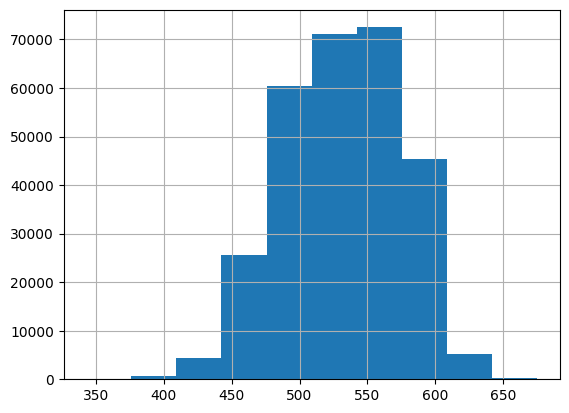

In [36]:
avg_pixel_season_sum.snow_depth_prediction.hist()

In [59]:
def create_season_maps_grid(df):
    seasons = sorted(df['snow_season'].unique())
    n_seasons = len(seasons)
    
    cols = 3
    rows = math.ceil(n_seasons / cols)
    
    specs = [[{"type": "scattermap"} for _ in range(cols)] for _ in range(rows)]
    
    fig = make_subplots(
        rows=rows, 
        cols=cols,
        subplot_titles=[f'Season {season}' for season in seasons],
        specs=specs,
        horizontal_spacing=0.01,
        vertical_spacing=0.01
    )
    
    # Calculate bounds from all data
    lat_min, lat_max = df['latitude'].min(), df['latitude'].max()
    lon_min, lon_max = df['longitude'].min(), df['longitude'].max()
    
    # Add some padding to bounds
    lat_padding = (lat_max - lat_min) * 0.5
    lon_padding = (lon_max - lon_min) * 0.5
    
    for i, season in enumerate(seasons):
        season_data = df[df['snow_season'] == season]
        
        row = (i // cols) + 1
        col = (i % cols) + 1
        
        fig.add_trace(
            go.Scattermap(
                lat=season_data['latitude'],
                lon=season_data['longitude'],
                mode='markers',
                marker=dict(
                    color=season_data['snow_depth_prediction'],
                    colorscale='Viridis',
                    cmin=350,
                    cmax=650,
                    size=8,
                    showscale=True if i == 0 else False,
                    colorbar=dict(title="Snow Depth Prediction") if i == 0 else None
                ),
                text=[f"Snow Depth: {val}" for val in season_data['snow_depth_prediction']],
                hovertemplate="<b>Season: " + season + "</b><br>" +
                             "Lat: %{lat}<br>" +
                             "Lon: %{lon}<br>" +
                             "%{text}<extra></extra>",
                showlegend=False
            ),
            row=row, col=col
        )
        
        # Set bounds for each map
        map_id = f'map{i+1}' if i > 0 else 'map'
        fig.update_layout(**{
            map_id: dict(
                style="open-street-map",
                bounds=dict(
                    west=lon_min - lon_padding,
                    east=lon_max + lon_padding,
                    south=lat_min - lat_padding,
                    north=lat_max + lat_padding
                )
            )
        })
    
    fig.update_layout(
        title_text="Snow Depth Predictions by Season",
        title_x=0.5,
        height=350 * rows,
        width=1400,
        margin=dict(l=20, r=80, t=80, b=20),
        showlegend=False
    )
    
    fig.show()

# Usage
create_season_maps_grid(avg_pixel_season_sum)

### Sum the average monthly pixels over the snow season

<Axes: xlabel='snow_season'>

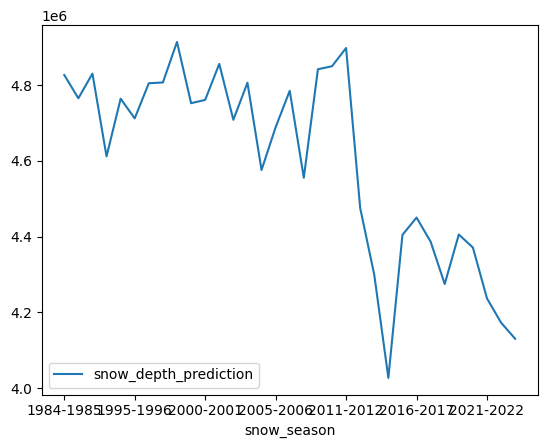

In [19]:
avg_pixel_months.groupby(['snow_season']).agg({'snow_depth_prediction': 'sum'}).plot()